In [1]:
import numpy as np
import os
import pandas as pd
import matplotlib
from matplotlib.collections import LineCollection
import matplotlib.pylab as plt
from matplotlib import rc
from sympy import latex
import csv
import seaborn as sns
import json
import plotly.express as px

In [79]:
# Load data inputs used in optimization model

generators = pd.read_csv("Data/GeneratorsNetwork.csv")
storage_elec = pd.read_csv("Data/Storage_ELECNetwork.csv")
storage_gas = pd.read_csv("Data/Storage_GASNetwork.csv")
p2g = pd.read_csv("Data/PowerToGasNetwork.csv")
appliances = pd.read_csv("Data/EndUseAppliancesNetwork.csv")
resources = pd.read_csv("Plots/generators.csv")

GEN = len(generators)
STORAGE_ELEC = len(storage_elec)
STORAGE_GAS = len(storage_gas)
P2G = len(p2g)

resource_list = np.append(np.append(np.append(generators["Prime Mover"].to_numpy(), storage_elec["Prime Mover"].to_numpy()), p2g["Prime Mover"].to_numpy()), storage_gas["Prime Mover"].to_numpy())
resource_list = np.where(resource_list == "Net-zero CH4", "Electro-methane",resource_list)
resource_list_GEN = (generators["Prime Mover"].to_numpy())
resource_list_P2G = (p2g["Prime Mover"].to_numpy())
resource_list_P2G = np.where(resource_list_P2G == "Net-zero CH4", "Electro-methane",resource_list_P2G)

unique_resources = np.append(np.append(np.append(generators["Prime Mover"].drop_duplicates().to_numpy(), storage_elec["Prime Mover"].drop_duplicates().to_numpy()), p2g["Prime Mover"].drop_duplicates().to_numpy()), storage_gas["Prime Mover"].drop_duplicates().to_numpy())
unique_resources_GEN = generators["Prime Mover"].drop_duplicates().to_numpy()
unique_resources_STORAGE = np.append(storage_elec["Prime Mover"].drop_duplicates().to_numpy(), storage_gas["Prime Mover"].drop_duplicates().to_numpy())
unique_resources_P2G = p2g["Prime Mover"].drop_duplicates().to_numpy()
unique_resources_P2G = np.where(unique_resources_P2G == "Net-zero CH4", "Electro-methane",unique_resources_P2G)

locational_resources = np.append(np.append(np.append(generators["Node_ELEC"].to_numpy(), storage_elec["Node_ELEC"].to_numpy()), p2g["Node_ELEC"].to_numpy()), storage_gas["Node_ELEC"].to_numpy())
locational_resources_GEN = generators["Node_ELEC"].to_numpy()

appliances = pd.read_csv("Data/EndUseAppliancesNetwork.csv")
appliances_gascons = pd.read_csv("Data/ApplianceProfiles_GASNetworkCold.csv")
appliances_eleccons = pd.read_csv("Data/ApplianceProfiles_ELECNetworkCold.csv")
unique_appliancetypes =  appliances["Appliance Name"].drop_duplicates().to_numpy()
appliances_list = appliances["Appliance Name"].to_numpy()
locational_resources_appliances = appliances["Node_ELEC"].to_numpy()

unique_appliancetypes_RES = unique_appliancetypes[[4,5,0,1,2,10,3,11]]
unique_appliancetypes_COMM = unique_appliancetypes[[6,7,8,12,9,13]]

In [84]:
# Set plotting parameters (font, labels, colors)

rc('font', **{'family': 'serif', 'serif': ['Computer Modern'],'size':18})
rc('text', usetex=True)

resources = pd.read_csv("Plots/generators.csv")
resource_list = resources["Clumps"].to_numpy()
resource_list_GEN = resource_list[:237]
unique_resources = resources["Clumps"].drop_duplicates().to_numpy()
unique_resources = np.array(['Coal', 'Natural Gas','Natural Gas + CCS', 'Biomass', 'Geothermal','Enhanced Geothermal', 'Nuclear',
 'Hydro', 'Solar PV', 'Wind', 'Offshore Wind',
 'Short-Duration Storage', 'Long-Duration Storage','Power-to-Gas'])
unique_resources_GEN = unique_resources[:-3]
colors = np.array(['#000000','#888888','#aeaeae', '#1E88E5', '#E94C1F','#f08465', '#A01813',
    '#C6DBED', '#F9D576','#60BCE9', '#238F9D', 
    '#FFB954', '#F57634','#125A56'])
colors_GEN = colors[:-3]

p2g = pd.read_csv("Data/PowerToGasNetwork.csv")
resource_list_P2G = (p2g["Prime Mover"].to_numpy())
resource_list_P2G = np.where(resource_list_P2G == "Net-zero CH4", "Electro-methane",resource_list_P2G)
unique_resources_P2G = np.array(['Biomethane', 'Net-zero CH4','Electrolytic Hydrogen'])
unique_resources_P2G = np.where(unique_resources_P2G == "Net-zero CH4", "Electro-methane",unique_resources_P2G)
colors_P2G = np.array(['#125A56', '#238F9D','#60BCE9'])

appliance_labels = ["Gas Range","Electric Range","Gas Water Heater","Electric Water Heater","Gas Space Heater","Gas Space Heater + AC","Electric Space Heater","Electric Space Heater"]
appliance_labels_COMM = ["Gas Water Heater","Electric Resistance Water Heater","Gas Space Heater","Gas Space Heater + AC","Electric Space Heater","Electric Space Heater"]
colors_ResApps = ["#E94C1F","#ECEADA","#A01813","#FDDBC7","#125A56","#00767B","#DEE6E7","#DEE6E7"]
colors_CommApps = ["#A01813","#FDDBC7","#125A56","#00767B","#DEE6E7","#DEE6E7"]

colors_Costs = ["#00767B","#42A7C6",
    "#9DCCEF","#C6DBED","#DEE6E7",
    "#D11807","#F57634","#FFB954",
    "#ECEADA","#125A56","#888888"]
labels_Costs = ["Electric Generation - Capital","Electric Generation - Operating",
    "Electric Transmission","Electric Distribution","Electric Storage",
    "Natural Gas Commodity Costs","Gas Distribution","Gas Storage",
    "End-Use Appliances","Power-to-Gas","Negative Emissions"]

colors_emissions = ["#00767B","#E94C1F"]
labels_emissions = ["Power Generation Emissions", "Other Gas Demand Emissions"]

In [75]:
# Set up case folder

to_plot = True
caseNum = 1
date_stamps = ["v3/Offset 20"] 
case_studies = date_stamps
case_names = date_stamps

case1 = case_names[caseNum-1]
date_stamp1 = date_stamps[caseNum-1]
case_study = "Reference"

folder = "core/Output/%s" % date_stamp1

T_inv = 1
Years = 2020
T_inv = 5
Years = np.array([2025,2030,2035,2040,2045])

## Gas and Electric Capacity Expansion and Annual Generation

Coal 0.00031318357015975716
Natural Gas 0.052675071058716334
Natural Gas + CCS 0.9639966764791822
Biomass 4.800632509283886
Geothermal 2.9001886512952924
Enhanced Geothermal 19.20049425988631
Nuclear 0.0
Hydro 0.0
Solar PV 49.10361123557146
Wind 14.501635984008226
Offshore Wind 30.61448892213545
Short-Duration Storage 14.266742508077797
Long-Duration Storage 3.1697120055254513
Power-to-Gas 39.58179338798125
Installed Capacity:  [  9.40391467  32.11259047  73.02238674 114.84611228 179.15628439] 

Retired Capacity:  [-23.97329281 -25.6086721  -41.3776336  -44.6860124  -54.31680682] 

Coal [1.64545959e+01 1.32487149e+01 1.63062669e+01 6.98006902e-03
 1.83317813e-06]
Natural Gas [107.91073708  92.11297166  63.20362519  72.67420802   1.11217006]
Natural Gas + CCS [6.60017845e-04 9.13364239e-04 1.52451923e-03 4.24148007e-03
 2.61166873e+00]
Biomass [ 0.44334042  0.86864321  1.4693926   6.88054225 49.43885126]
Geothermal [17.31706899 17.31705118 20.38312904 25.28894995 35.0150718 ]
Enhanced G

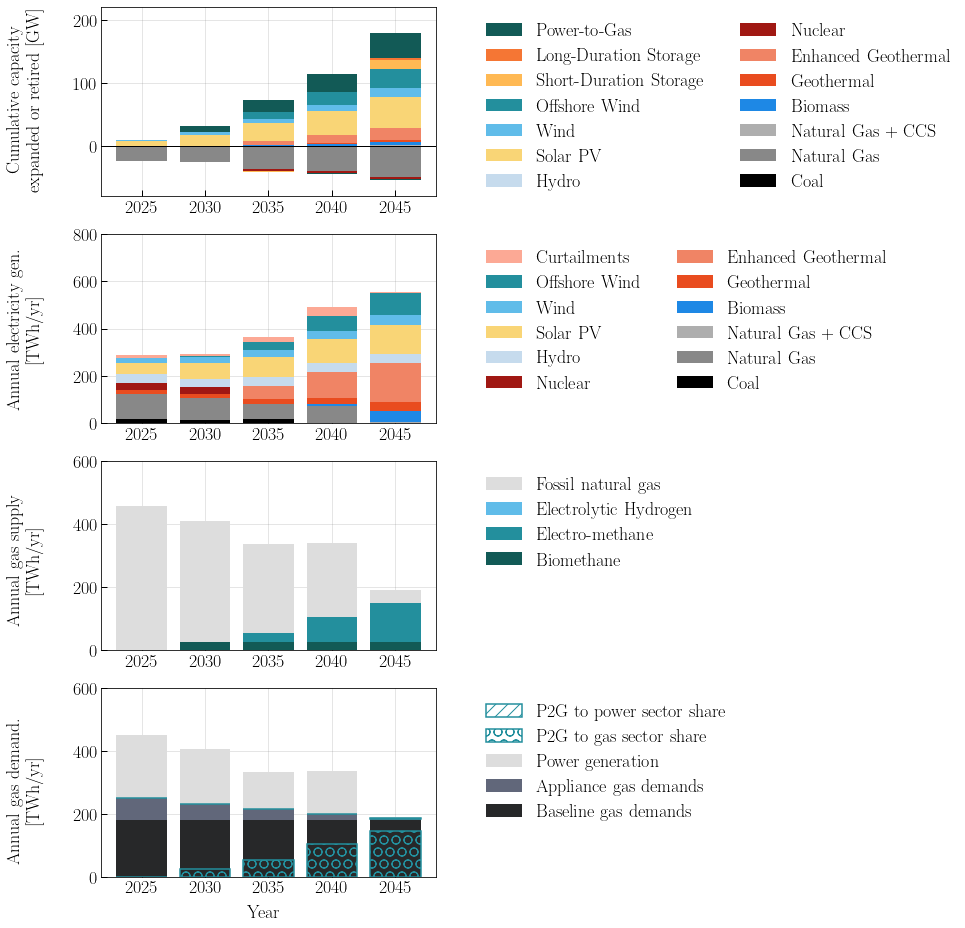

In [82]:
fig, axes = plt.subplots(4, 1, figsize = (6,16))

#############################
## Total capacity built and retired
resources = np.zeros((len(unique_resources),T_inv))
resources_minus = np.zeros((len(unique_resources),T_inv))
cap_built = pd.read_csv(f"%s/CAPACITY_BUILT.csv" % folder).to_numpy()
cap_built = cap_built[0:-1,:]
cap_retired = pd.read_csv(f"%s/CAPACITY_RETIRED.csv" % folder).to_numpy()
cap_retired = cap_retired[0:-1,:]
hourly_load = pd.read_csv(f"%s/HOURLY_LOAD.csv" % folder).to_numpy()
stack = np.zeros((T_inv))
stack_minus = stack.copy()

for k in range(len(unique_resources)):
    for j in range(T_inv):
        for jj in range(j+1):
            resources_minus[k,j] = resources_minus[k,j]+np.sum(cap_retired[resource_list == unique_resources[k],jj],0)
            resources[k,j] = resources[k,j]+np.sum(cap_built[resource_list == unique_resources[k],jj],0)
    
    if sum(resources[k,:]) > 0:
        axes[0].bar(Years, resources[k,:]/10**3, label = unique_resources[k], bottom = stack, width = 4, align = "center", color = colors[k])
        stack = stack + resources[k,:]/10**3
    if sum(resources_minus[k,:]) > 0:
        if sum(resources[k,:]) > 0:
            axes[0].bar(Years, -1*resources_minus[k,:]/10**3, bottom = stack_minus, width = 4, align = "center", color = colors[k])
        if sum(resources[k,:]) <= 0:
            axes[0].bar(Years, -1*resources_minus[k,:]/10**3, label = unique_resources[k], bottom = stack_minus, width = 4, align = "center", color = colors[k])
        stack_minus = stack_minus - resources_minus[k,:]/10**3
    
    print(unique_resources[k],resources[k,j]/10**3)
    if k == len(unique_resources)-1:
        print("Installed Capacity: ",stack, "\n")
        print("Retired Capacity: ",stack_minus, "\n")

#############################
## Total electric generation
generation = pd.read_csv(f"%s/GENERATION.csv" % folder).to_numpy()
data_elec = generation[GEN+P2G:GEN+P2G+8,:].copy()
generation = generation[0:GEN,:].copy()
stack = np.zeros((T_inv))
for k in range(len(unique_resources_GEN)):
    resources = np.sum(generation[resource_list_GEN == unique_resources_GEN[k],:],0)
    axes[1].bar(Years, resources/10**6, label = unique_resources_GEN[k],color = colors_GEN[k], bottom = stack, width = 4, align = "center")
    stack = stack + resources/10**6
    print(unique_resources_GEN[k],resources/10**6)
    if k == len(unique_resources_GEN)-1:
        print("Total Generation: ",stack, "\n")
resources = data_elec[7,:].copy()
axes[1].bar(Years, resources/10**6, label = "Curtailments", color = "#FCA995", linewidth = 2, ls = "--", bottom = stack, width = 4, align = "center")
electricity_stack = stack

resources = np.ones([1,5]) * data_elec[4,0].copy()
stack = np.zeros((T_inv))
# axes[1].bar(Years, resources[0]/10**6, label = "Initial electricity demand", color = "none", alpha = 1, edgecolor = 'tomato', linewidth = 2, ls = "--", bottom = stack, width = 4, align = "center")
resources = data_elec[5,:].copy()
stack = np.zeros((T_inv))
# axes[1].bar(Years, resources/10**6, label = "Final electricity demand", color = "none", alpha = 1, edgecolor = 'k', linewidth = 2, bottom = stack, width = 4, align = "center")

#############################
## Total annual gas generation
generation = pd.read_csv(f"%s/GENERATION.csv" % folder).to_numpy()
data_gas = generation[GEN+P2G:GEN+P2G+9,:]
generation = generation[GEN:GEN+P2G,:]
stack = np.zeros((T_inv))
for k in range(len(unique_resources_P2G)):
    resources = np.sum(generation[resource_list_P2G == unique_resources_P2G[k],:],0)
    axes[2].bar(Years, resources/10**6, label = unique_resources_P2G[k],color = colors_P2G[k], bottom = stack, width = 4, align = "center")
    stack = stack + resources/10**6
    
axes[2].bar(Years, np.maximum(data_gas[6,:].copy()/10**6,0), label = "Fossil natural gas", color = "#DDDDDD", bottom = stack, width = 4, align = "center")

#############################
## Total annual gas demand
data_baselinegas = np.sum(hourly_load[3,int((0)*24):int((365)*24)]) #kWh baseline gas consumption/yr

stack = np.zeros((T_inv))
resources_bg = np.ones([5]) * data_baselinegas/10**6
axes[3].bar(Years, resources_bg, label = "Baseline gas demands", color = "#272829", alpha = 1, bottom = stack, width = 4, align = "center")
resources = data_gas[1,:].copy()/10**6 - resources_bg
axes[3].bar(Years, resources, label = "Appliance gas demands", color = "#61677A", alpha = 1, bottom = resources_bg, width = 4, align = "center")
axes[3].bar(Years, np.maximum((data_gas[8,:].copy())/10**6,0), label = "Power generation",color = "#DDDDDD", alpha = 1, bottom = resources_bg+resources, width = 4, align = "center")
print("Gas Demands :", resources_bg+resources+data_gas[8,:].copy()/10**6)
print("Other Gas :", resources_bg)
print("Appliances :", resources)
print("Power Generation :", data_gas[8,:].copy()/10**6)

stack = np.zeros((T_inv))
resources3 = data_gas[3,:].copy()
axes[3].bar(Years, resources3/10**6, label = "P2G to gas sector share", color = "none", alpha = 1, hatch='O', edgecolor = '#238F9D',linewidth = 1.5, bottom = stack, width = 4, align = "center")

resources2 = data_gas[2,:].copy()
axes[3].bar(Years, resources2/10**6, label = "P2G to power sector share", color = "none", alpha = 1, hatch='//',edgecolor = '#238F9D',linewidth = 1.5, bottom = resources_bg+resources, width = 4, align = "center")
for ii in range(4):
    axes[ii].axhline(linewidth=1, color='k')
    axes[ii].tick_params(direction='in', length=6, width=1, colors='k')

for i in range(4):
    handles, labels = axes[i].get_legend_handles_labels()
    labels = np.where(np.array(labels) == "Electrolysis","Electrolytic hydrogen",np.array(labels))
    if i==0:
        axes[i].legend(handles[::-1], labels[::-1], bbox_to_anchor=(1.1, 1.0), loc='upper left',ncol=2,frameon=False)
    elif i ==1:
        axes[i].legend(handles[::-1], labels[::-1], bbox_to_anchor=(1.1, 1.0), loc='upper left',ncol=2,frameon=False)
    else:
        axes[i].legend(handles[::-1], labels[::-1], bbox_to_anchor=(1.1, 1), loc='upper left',frameon=False)
    axes[i].set_axisbelow(True)
    axes[i].grid(color='grey', linestyle='-', linewidth=1,alpha = 0.2)

fig.text(-0.05, 0.8, 'Cumulative capacity \n expanded or retired [GW]', ha='center', va='center', rotation='vertical')
fig.text(-0.05, 0.6, 'Annual electricity gen. \n [TWh/yr]', ha='center', va='center', rotation='vertical')
fig.text(-0.05, 0.4, 'Annual gas supply \n [TWh/yr]', ha='center', va='center', rotation='vertical')
fig.text(-0.05, 0.2, 'Annual gas demand. \n [TWh/yr]', ha='center', va='center', rotation='vertical')

axes[0].set_ylim([-80,220])
axes[1].set_ylim([0,800])
axes[2].set_ylim([0,600])
axes[3].set_ylim([0,600])
fig.text(0.5, 0.09, 'Year', ha='center')
if to_plot:
    fig.savefig(f"Plots/{case_study}/Investment_Period.png",bbox_inches = "tight", dpi = 300)
plt.show()

## End-Use Appliance Decisions

<ipython-input-76-536a16d0dc7e>:51: UserWarning:

FixedFormatter should only be used together with FixedLocator



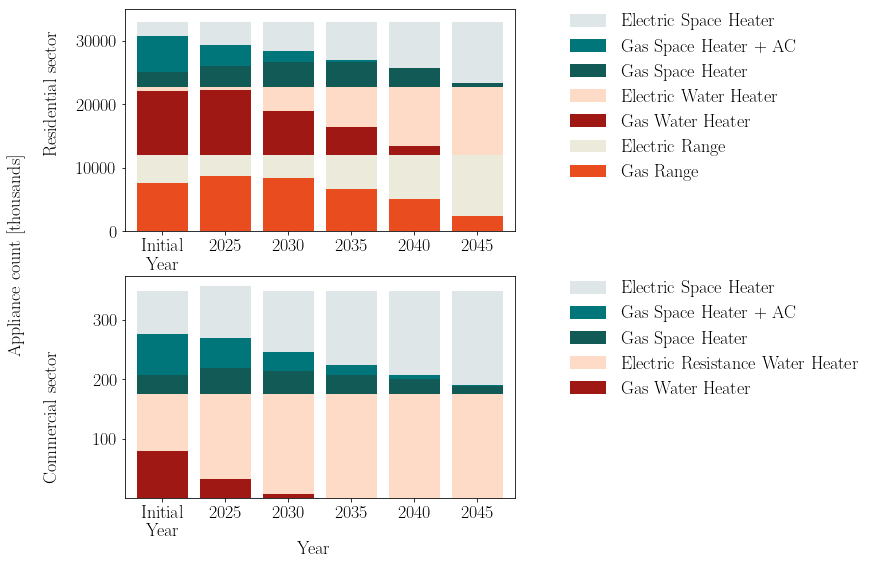

In [76]:
fig, axes = plt.subplots(2, 1, figsize = (7,9), sharex = False, sharey = False)
appliance_labels = ["Gas Range","Electric Range","Gas Water Heater","Electric Water Heater","Gas Space Heater","Gas Space Heater + AC","Electric Space Heater","Electric Space Heater"]
appliance_labels_COMM = ["Gas Water Heater","Electric Resistance Water Heater","Gas Space Heater","Gas Space Heater + AC","Electric Space Heater","Electric Space Heater"]
colors_ResApps = ["#E94C1F","#ECEADA","#A01813","#FDDBC7","#125A56","#00767B","#DEE6E7","#DEE6E7"]
colors_CommApps = ["#A01813","#FDDBC7","#125A56","#00767B","#DEE6E7","#DEE6E7"]

appliances = pd.read_csv("Data/EndUseAppliancesNetwork.csv")
initial_pop = appliances["Appliance Count [no.]"]/1000
NewYears = np.array([2020,2025,2030,2035,2040,2045])

resources = np.zeros((len(unique_appliancetypes),1))
data = pd.read_csv(f"%s/APPLIANCE_DECISIONS.csv" % folder).to_numpy()
newbuild = np.zeros((len(data[:,0]),T_inv))
premature = np.zeros((len(data[:,0]),T_inv))
totalpop = np.zeros((len(data[:,0]),T_inv))
for k in range(T_inv):
    newbuild[:,k] = data[:,k*3]
    premature[:,k] = data[:,k*3+1]
    totalpop[:,k] = data[:,k*3+2]
newtotalpop = np.zeros((len(data[:,0]),T_inv+1))
newtotalpop[:,0] = initial_pop
newtotalpop[:,1:6] = totalpop
stack = np.zeros((T_inv+1))
for k in range(len(unique_appliancetypes_RES)-1):
    resources = np.sum(newtotalpop[appliances_list == unique_appliancetypes_RES[k],:],0)
    if k == len(unique_appliancetypes_RES) - 2:
        resources += np.sum(newtotalpop[appliances_list == unique_appliancetypes_RES[k+1],:],0)
    axes[0].bar(NewYears, resources,color = colors_ResApps[k],label = appliance_labels[k], bottom = stack, width = 4, align = "center")
        
    stack = stack + resources

stack = np.zeros((T_inv+1))
for k in range(len(unique_appliancetypes_COMM)-1):
    resources = np.sum(newtotalpop[appliances_list == unique_appliancetypes_COMM[k],:],0)
    if k == len(unique_appliancetypes_COMM) - 2:
        resources += np.sum(newtotalpop[appliances_list == unique_appliancetypes_COMM[k+1],:],0)
    axes[1].bar(NewYears, resources,color = colors_CommApps[k],label = appliance_labels_COMM[k], bottom = stack, width = 4, align = "center")

    stack = stack + resources

fig.text(-0.09, 0.5, 'Appliance count [thousands]', ha='center', va='center', rotation='vertical')
fig.text(0.5, 0.04, 'Year', ha='center')
fig.text(-0.02, 0.75, 'Residential sector', ha='center', va='center', rotation='vertical')
fig.text(-0.02, 0.25, 'Commercial sector', ha='center', va='center', rotation='vertical')

for i in range(2):
    handles, labels = axes[i].get_legend_handles_labels()
    axes[i].legend(handles[::-1], labels[::-1], bbox_to_anchor=(1.1, 1.05), loc='upper left',frameon=False)      
    axes[i].set_xlim([2017,2048])
    labels = [0,"Initial\nYear",2025,2030,2035,2040,2045]
    axes[i].set_xticklabels(labels)
axes[0].set_ylim([0,35000])
if to_plot:
    fig.savefig(f"Plots/{case_study}/Appliances_Decisions.png",bbox_inches = "tight", dpi = 300)
plt.show()


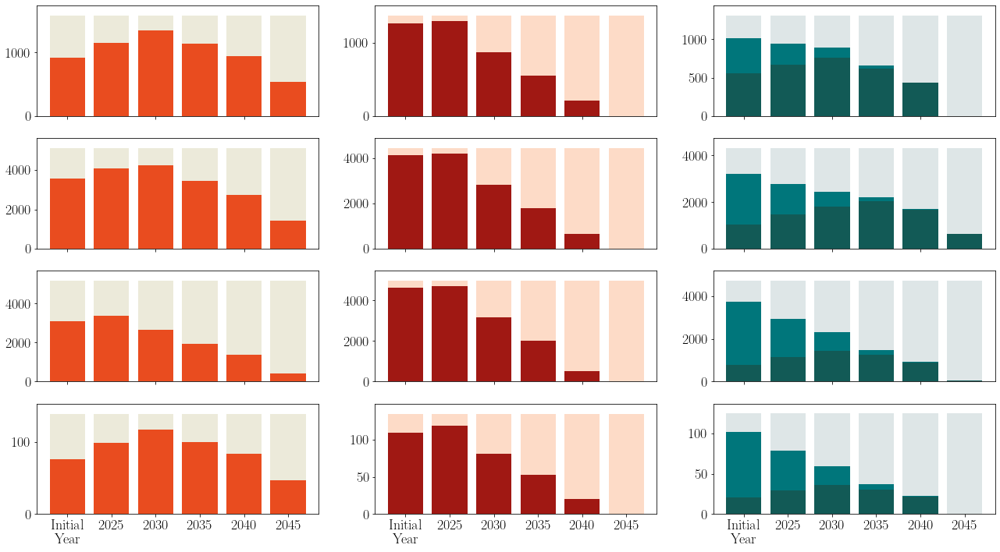

In [77]:
fig, axes = plt.subplots(4, 3, figsize=(22, 12), sharex=False, sharey=False)

data = newtotalpop

# Define region labels
regions = ["Coastal North", "Coastal South", "Inland","Mountain"]
select = [[1,3],[5,6,7,8,9],[2,4,10,11,12,13,14,15],[16]]

appliance_types = ['Water Heater', 'Space Heater', 'Range']
loc = [1,2,0]
energy_types = ['Gas', 'Electric']
bar_width = 4

for i, appliance_type in enumerate(appliance_types):
    for j,region in enumerate(select): 
        ax = axes[j,loc[i]]  # Select the current subplot
        electric_data = 0
        gas_data = 0
        gasac_data = 0
        for cz in select[j]:
            region_index = cz - 1
            years = NewYears
            ind = region_index + (i*16*2)
            ind_e = (region_index+16) + (i*16*2)
            gas_data += data[ind]
            electric_data += data[ind_e]
            if appliance_type == appliance_types[0]:
                ic = i+3
                ind = region_index + (ic*16*2)
                ind_e = (region_index+16) + (ic*16*2)
                gas_data += data[ind]
                electric_data += data[ind_e]
            if appliance_type == appliance_types[1]:
                for m in range(3):
                    ic = (i+m+3)
                    ind = region_index + (ic*16*2)
                    ind_e = (region_index+16) + (ic*16*2)
                    if m > 0: # with AC
                        gasac_data += data[ind]
                    else:
                        gas_data += data[ind]
                    electric_data += data[ind_e]

        # Plot gas and electric separately with legends
        ax.bar(years, gas_data, label=f'Gas {appliance_type}', color=colors_ResApps[loc[i] * 2],width = bar_width)
        if appliance_type == appliance_types[1]:
            ax.bar(years, gasac_data, label=f'Gas {appliance_type}', bottom=gas_data,color="#00767B",width = bar_width)
            ax.bar(years, electric_data, label=f'Electric {appliance_type}', bottom=gas_data+gasac_data, color="#DEE6E7", width = bar_width)
        else:
            ax.bar(years, electric_data, label=f'Electric {appliance_type}', bottom=gas_data, color=colors_ResApps[loc[i]*2+1], width = bar_width)
        ax.set_ylim(0, np.max(np.sum([gas_data,electric_data],axis = 0))*1.1)
        ax.xaxis.set_ticklabels([])
        if j == 3:
            labels = ['Initial \n Year',2025,2030,2035,2040,2045]
            ax.set_xticks(np.arange(2020, 2050, step=5), labels)

# fig.text(.075, 0.5, 'Appliance count [thousands]', ha='center', va='center', rotation='vertical',fontsize = 18)
# fig.text(.21, .95, 'Coastal North (CZs 1,3)', ha='center', va='center', rotation='horizontal',fontsize = 18)
# fig.text(.41, .95, 'Coastal South (CZs 5-9)', ha='center', va='center', rotation='horizontal',fontsize = 18)
# fig.text(.61, .95, 'Inland (CZs 2,4,10-15)', ha='center', va='center', rotation='horizontal',fontsize = 18)
# fig.text(.81, .95, 'Mountain (CZ 16)', ha='center', va='center', rotation='horizontal',fontsize = 18)

if to_plot:
    fig.savefig(f"Plots/{case_study}/Appliances_Decisions_byRegion_select.png",bbox_inches = "tight", dpi = 300)
plt.show()


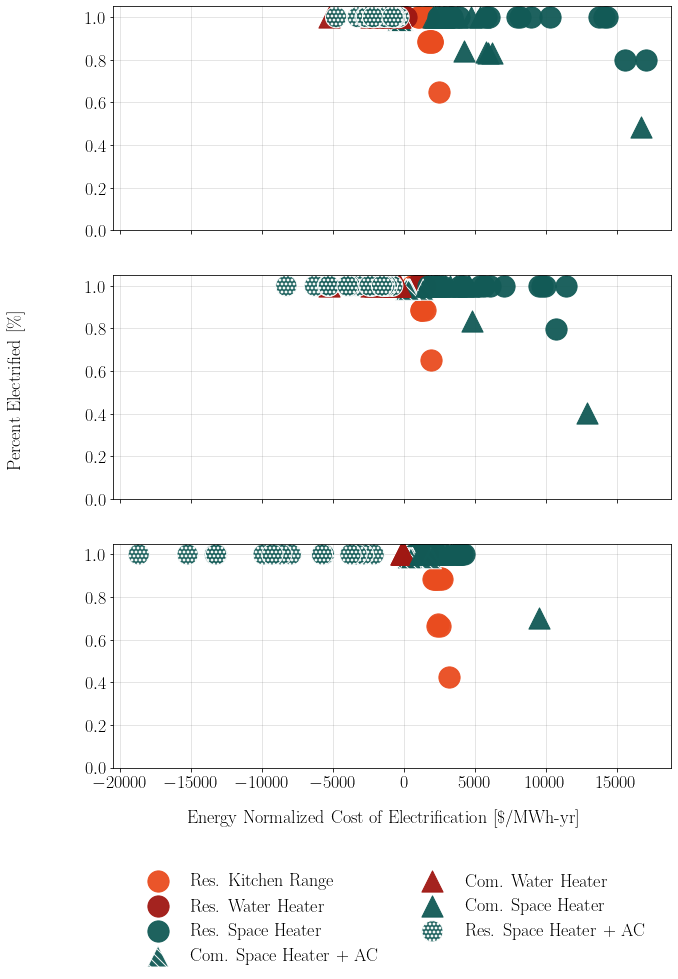

In [68]:
# Plot by appliance cost case

colors_Apps = ["#A01813","#125A56","#E94C1F","#A01813","#125A56","#125A56","#125A56"]
data = pd.read_csv("Plots/appliances.csv")
appliancecount = data["Appliance Count"].values.reshape(7, -1)

fig, ax = plt.subplots(3, 1, figsize = (10,14), sharex = True, sharey = True)
appliance_labels = ["Res. Water Heater","Res. Space Heater","Res. Kitchen Range","Com. Water Heater","Com. Space Heater","Res. Space Heater + AC","Com. Space Heater + AC"]
my_case = ["Net Cost [High]","Net Cost [Mid]","Net Cost [Low]"]
folderZ = ["core/Output/v3/App High/APPLIANCE_DECISIONS.csv","core/Output/v3/R10/APPLIANCE_DECISIONS.csv","core/Output/v3/App Low/APPLIANCE_DECISIONS.csv"]

my_size = 450
my_alpha = .95
for j in range(3):
    axes = ax[j]
    netcost_plot = data[my_case[j]].values.reshape(7, -1)
    dataX = pd.read_csv(folderZ[j])
    remainingcount = dataX["Column15"].values.reshape(14, -1)
    remainingcount = remainingcount[1::2, :]
    electrified = remainingcount*1000./appliancecount
    for i in [2,0,1,6,3,4,5]:
        if i == 3 or i == 4:
            axes.scatter(netcost_plot[i,:], electrified[i,:], color=colors_Apps[i], label=appliance_labels[i],s=my_size,marker='^',alpha=my_alpha)
        elif i == 6:
            axes.scatter(netcost_plot[i,:], electrified[i,:], color=colors_Apps[i], label=appliance_labels[i],s=my_size,marker='^',hatch = 3*'\\',edgecolor='w',alpha=my_alpha)
        elif i == 5:
            axes.scatter(netcost_plot[i,:], electrified[i,:], color=colors_Apps[i], label=appliance_labels[i],s=my_size,hatch = 3*'o',edgecolor='w',alpha=my_alpha)
        else:
            axes.scatter(netcost_plot[i,:], electrified[i,:], color=colors_Apps[i], label=appliance_labels[i],s=my_size,alpha=my_alpha)
    axes.set_axisbelow(True)
    axes.grid(color='grey', linestyle='-', linewidth=1,alpha = 0.2)


fig.text(-0.01, 0.5, 'Percent Electrified [\%]', ha='center', va='center', rotation='vertical')
fig.text(0.5, 0.07, 'Energy Normalized Cost of Electrification [\$/MWh-yr]', ha='center')
handles, labels = ax[1].get_legend_handles_labels()
ax[2].legend(handles,labels,loc='upper center',bbox_to_anchor=(0.5, -0.4),fancybox=False, shadow=False, ncol=2,frameon=False)
axes.set_ylim(0,1.05)
# axes.set_xlim(8000,12000)
if to_plot:
    fig.savefig(f"Plots/{case_study}/Electrification_Cost.png",bbox_inches = "tight", dpi = 300)
plt.show()

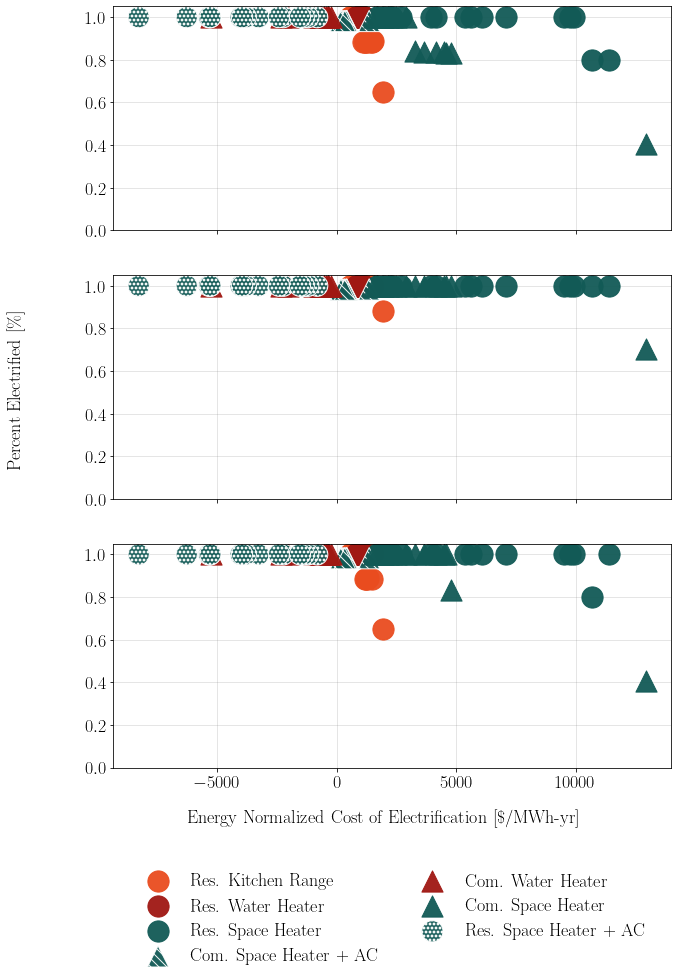

In [70]:
# Plot by other scenarios

colors_Apps = ["#A01813","#125A56","#E94C1F","#A01813","#125A56","#125A56","#125A56"]
data = pd.read_csv("Plots/appliances.csv")
appliancecount = data["Appliance Count"].values.reshape(7, -1)

fig, ax = plt.subplots(3, 1, figsize = (10,14), sharex = True, sharey = True)
appliance_labels = ["Res. Water Heater","Res. Space Heater","Res. Kitchen Range","Com. Water Heater","Com. Space Heater","Res. Space Heater + AC","Com. Space Heater + AC"]
my_case = "Net Cost [Mid]"
folderZ = ["core/Output/v3/H2 20/APPLIANCE_DECISIONS.csv","core/Output/v3/OSW Limited/APPLIANCE_DECISIONS.csv","core/Output/v3/R10/APPLIANCE_DECISIONS.csv"]

my_size = 450
my_alpha = .95
for j in range(3):
    axes = ax[j]
    netcost_plot = data[my_case].values.reshape(7, -1)
    dataX = pd.read_csv(folderZ[j])
    remainingcount = dataX["Column15"].values.reshape(14, -1)
    remainingcount = remainingcount[1::2, :]
    electrified = remainingcount*1000./appliancecount
    for i in [2,0,1,6,3,4,5]:
        if i == 3 or i == 4:
            axes.scatter(netcost_plot[i,:], electrified[i,:], color=colors_Apps[i], label=appliance_labels[i],s=my_size,marker='^',alpha=my_alpha)
        elif i == 6:
            axes.scatter(netcost_plot[i,:], electrified[i,:], color=colors_Apps[i], label=appliance_labels[i],s=my_size,marker='^',hatch = 3*'\\',edgecolor='w',alpha=my_alpha)
        elif i == 5:
            axes.scatter(netcost_plot[i,:], electrified[i,:], color=colors_Apps[i], label=appliance_labels[i],s=my_size,hatch = 3*'o',edgecolor='w',alpha=my_alpha)
        else:
            axes.scatter(netcost_plot[i,:], electrified[i,:], color=colors_Apps[i], label=appliance_labels[i],s=my_size,alpha=my_alpha)
    axes.set_axisbelow(True)
    axes.grid(color='grey', linestyle='-', linewidth=1,alpha = 0.2)


fig.text(-0.01, 0.5, 'Percent Electrified [\%]', ha='center', va='center', rotation='vertical')
fig.text(0.5, 0.07, 'Energy Normalized Cost of Electrification [\$/MWh-yr]', ha='center')
handles, labels = ax[1].get_legend_handles_labels()
ax[2].legend(handles,labels,loc='upper center',bbox_to_anchor=(0.5, -0.4),fancybox=False, shadow=False, ncol=2,frameon=False)
axes.set_ylim(0,1.05)
# axes.set_xlim(8000,12000)
if to_plot:
    fig.savefig(f"Plots/{case_study}/Electrification_Scenario2.png",bbox_inches = "tight", dpi = 300)
plt.show()

## Representative Days Heatmap

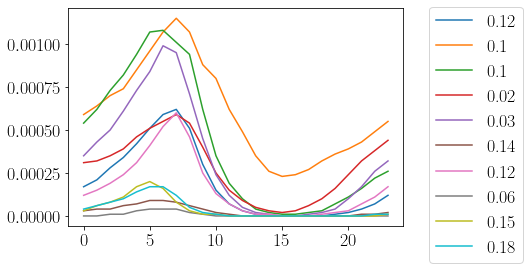

[0.62 1.15 1.08 0.59 0.99 0.09 0.6  0.04 0.2  0.17]


In [27]:
repdays = pd.read_csv(f"%s/REPDAYS.csv" % folder).to_numpy()
medoid = [39.0, 356.0, 324.0, 334.0, 316.0, 237.0, 41.0, 217.0, 172.0, 241.0]
num = [1, 2, 3, 4, 5, 6, 7, 8, 9, 10]
weights = [0.11506849315068493, 0.0958904109589041, 0.09863013698630137, 0.024657534246575342, 0.030136986301369864, 0.136986301369863, 0.11506849315068493, 0.06301369863013699, 0.14520547945205478, 0.17534246575342466]

sh_profile = pd.read_csv("Data/ApplianceProfiles_ELECNetworkCold.csv")

mat = np.zeros((len(medoid), 24),float)
peak = np.zeros((len(medoid)),float)
sh_cz3 = sh_profile["x50"]
for i in range(len(medoid)):
    day = int(medoid[i])
    profile = sh_cz3[(day-1)*24:(day)*24]
    peak[i] = max(profile)
    mat[i,:] = profile
    plt.plot(mat[i,:],label = round(weights[i],2))
plt.legend(bbox_to_anchor=(1.05, 1.05))
plt.show()
print(peak*1000)

new_ARR = repdays[:,0]* 0
sorted_val = [6,9,10,7,8,2,5,1,4,3]
for i in range(len(peak)):
    mask = (repdays[:,0] == i+1)
    indices = np.where(mask)
    new_ARR[indices] = sorted_val[i]

# with open("Plots/REPDAYS_ORDERED_10.csv", 'w', newline='') as csv_file:
#     writer = csv.writer(csv_file)
#     writer.writerow("C")
#     for value in new_ARR:
#         writer.writerow([value])

In [14]:
DAYS = ['Sun.', 'Mon.', 'Tues.', 'Wed.', 'Thurs.', 'Fri.', 'Sat.']
MONTHS = ['Jan.', 'Feb.', 'Mar.', 'Apr.', 'May', 'June', 'July', 'Aug.', 'Sept.', 'Oct.', 'Nov.', 'Dec.']


def date_heatmap(series, start=None, end=None, mean=False, ax=None, **kwargs):
    '''Plot a calendar heatmap given a datetime series.

    Arguments:
        series (pd.Series):
            A series of numeric values with a datetime index. Values occurring
            on the same day are combined by sum.
        start (Any):
            The first day to be considered in the plot. The value can be
            anything accepted by :func:`pandas.to_datetime`. The default is the
            earliest date in the data.
        end (Any):
            The last day to be considered in the plot. The value can be
            anything accepted by :func:`pandas.to_datetime`. The default is the
            latest date in the data.
        mean (bool):
            Combine values occurring on the same day by mean instead of sum.
        ax (matplotlib.Axes or None):
            The axes on which to draw the heatmap. The default is the current
            axes in the :module:`~matplotlib.pyplot` API.
        **kwargs:
            Forwarded to :meth:`~matplotlib.Axes.pcolormesh` for drawing the
            heatmap.

    Returns:
        matplotlib.collections.Axes:
            The axes on which the heatmap was drawn. This is set as the current
            axes in the `~matplotlib.pyplot` API.
    '''
    # Combine values occurring on the same day.
    dates = series.index.floor('D')
    group = series.groupby(dates)
    series = group.mean() if mean else group.sum()

    # Parse start/end, defaulting to the min/max of the index.
    start = pd.to_datetime(start or series.index.min())
    end = pd.to_datetime(end or series.index.max())

    # We use [start, end) as a half-open interval below.
    end += np.timedelta64(1, 'D')

    # Get the previous/following Sunday to start/end.
    # Pandas and numpy day-of-week conventions are Monday=0 and Sunday=6.
    start_sun = start - np.timedelta64((start.dayofweek + 1) % 7, 'D')
    end_sun = end + np.timedelta64(7 - end.dayofweek - 1, 'D')

    # Create the heatmap and track ticks.
    num_weeks = (end_sun - start_sun).days // 7
    heatmap = np.zeros((7, num_weeks))
    ticks = {}  # week number -> month name
    for week in range(num_weeks):
        for day in range(7):
            date = start_sun + np.timedelta64(7 * week + day, 'D')
            if date.day == 1:
                ticks[week] = MONTHS[date.month - 1]
            if date.dayofyear == 1:
                ticks[week] += f'\n{date.year}'
            if start <= date < end:
                heatmap[day, week] = series.get(date, 0)

    # Get the coordinates, offset by 0.5 to align the ticks.
    y = np.arange(8) - 0.5
    x = np.arange(num_weeks + 1) - 0.5

    # Plot the heatmap. Prefer pcolormesh over imshow so that the figure can be
    # vectorized when saved to a compatible format. We must invert the axis for
    # pcolormesh, but not for imshow, so that it reads top-bottom, left-right.
    ax = ax or plt.gca()
    mesh = ax.pcolormesh(x, y, heatmap, **kwargs)
    ax.invert_yaxis()

    # Set the ticks.
    ax.set_xticks(list(ticks.keys()))
    ax.set_xticklabels(list(ticks.values()))
    ax.set_yticks(np.arange(7))
    ax.set_yticklabels(DAYS)

    # Set the current image and axes in the pyplot API.
    plt.sca(ax)
    plt.sci(mesh)

    return ax


def date_heatmap_demo(filename,no_repday,plot):
    '''An example for `date_heatmap`.

    Most of the sizes here are chosen arbitrarily to look nice with 1yr of
    data. You may need to fiddle with the numbers to look right on other data.
    '''
    # Get some data, a series of values with datetime index.
    # data = pd.read_csv(f"%s/{filename}.csv" % folder).to_numpy()
    data = pd.read_csv(f"Plots/{filename}.csv").to_numpy()
    data = pd.Series(data[:,0])
    # data = np.random.randint(5, size=365)
    # data = pd.Series(data)
    data.index = pd.date_range(start='2018-01-01', end='2018-12-31', freq='1D')

    # Create the figure. For the aspect ratio, one year is 7 days by 53 weeks.
    # We widen it further to account for the tick labels and color bar.
    figsize = plt.figaspect(10 / 56)
    fig = plt.figure(figsize=figsize)

    # Plot the heatmap with a color bar.
    ax = date_heatmap(data, edgecolor='black')
    # plt.colorbar(ticks=range(6), pad=0.02, label='Rep. Day')
    plt.colorbar(ticks=range(no_repday+1), pad=0.02, label='Rep. Day')

    # Use a discrete color map with 5 colors (the data ranges from 0 to 4).
    # Extending the color limits by 0.5 aligns the ticks in the color bar.
    # cmap = plt.cm.get_cmap('Blues', 5)
    # plt.set_cmap(cmap)
    # plt.clim(0.5, 5.5)
    cmap = plt.cm.get_cmap('RdYlBu', no_repday)
    plt.set_cmap(cmap)
    plt.clim(0.5, no_repday+0.5)

    # Force the cells to be square. If this is set, the size of the color bar
    # may look weird compared to the size of the heatmap. That can be corrected
    # by the aspect ratio of the figure or scale of the color bar.
    ax.set_aspect('equal')
    plt.show()

    # Save to a file. For embedding in a LaTeX doc, consider the PDF backend.
    # http://sbillaudelle.de/2015/02/23/seamlessly-embedding-matplotlib-output-into-latex.html
    if to_plot:
        fig.savefig(f"Plots/Validation/RepDays.png",bbox_inches = "tight", dpi = 300)

    # The firgure must be explicitly closed if it was not shown.
    # plt.close(fig)



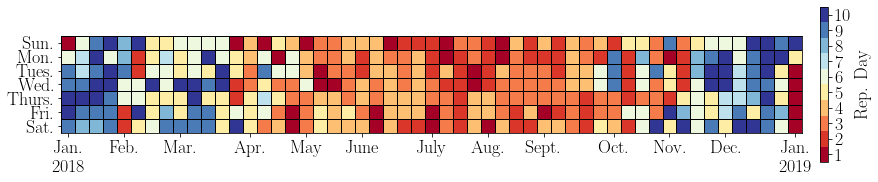

In [55]:
date_heatmap_demo("REPDAYS_ORDERED_10",10,1)

## Hourly Dispatch

3744 3912
-0.013958472934526596
869.4811529194336
580.0010125209552


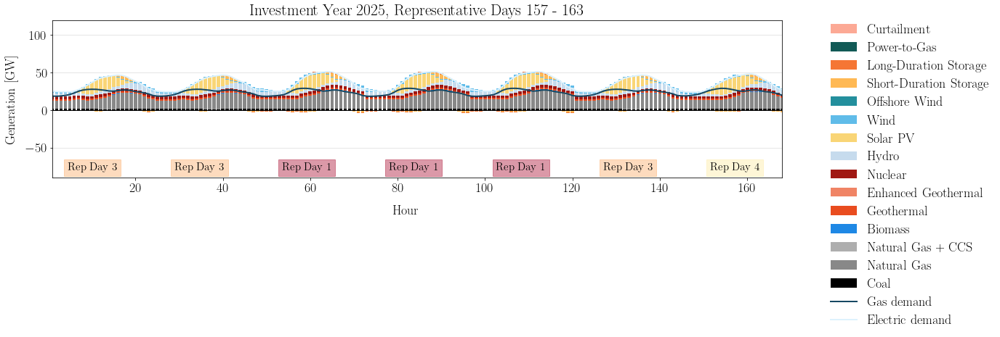

21264 21432
-339.0422392983225
889.6102898801039
521.0776576645131


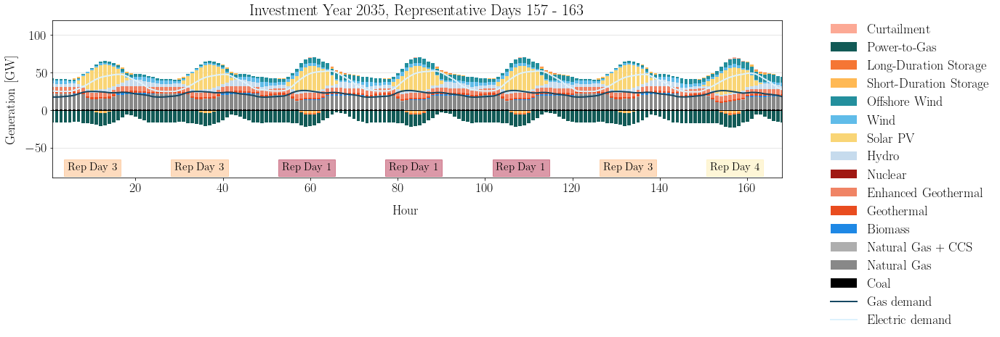

38784 38952
-547.4828457088695
1046.6776219022797
348.99912582472086


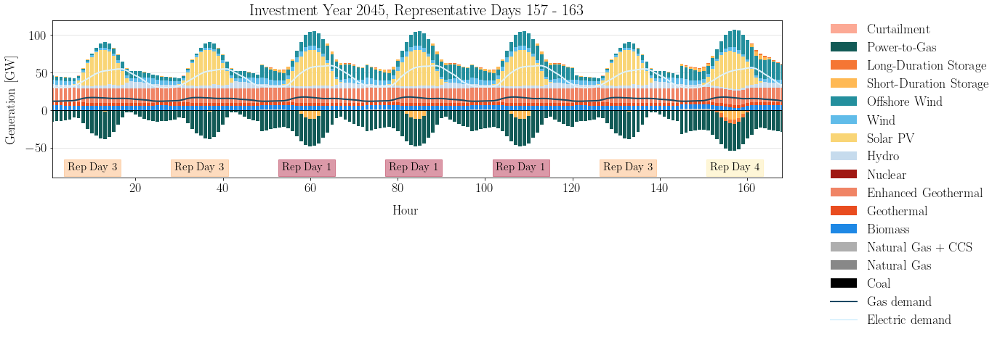

In [23]:
resource_list_hourly = resource_list[:518]
unique_resources_hourly = unique_resources
unique_resources_P2G = np.array(['Power-to-Gas'])
unique_resources_STORAGE = np.array(['Short-Duration Storage', 'Long-Duration Storage'])
colors_STORAGE = colors[-3:-1]

repday = pd.read_csv("Plots/REPDAYS_ordered_10.csv").to_numpy()
repday = pd.Series(repday[:,0]).astype(int)

d = 7
nn = -5
iit = 1 # yr for comparison
appliance_cases = np.array([case1])

dataX = pd.read_csv(f"%s/HOURLY_GENERATION.csv" % folder).to_numpy()
data2X = pd.read_csv(f"%s/HOURLY_LOAD.csv" % folder).to_numpy()

# all_yr = [0,1,2,3,4]
all_yr = [0,2,4]
for yr in all_yr:
    fig, axes = plt.subplots(1, 1, figsize = (18,4), sharex = True, sharey = True)
    for i in range(len(appliance_cases)):
        stack = np.zeros((d*24))
        
        if i == 0:
            cd = 156

        data = dataX[0:-1,int(yr*8760 + (cd)*24):int(yr*8760 + (cd)*24 + d*24)]/1000
        data2 = data2X[:,int(yr*8760 + (cd)*24):int(yr*8760 + (cd)*24 + d*24)]/1000
        print(int(yr*8760 + (cd)*24),int(yr*8760 + (cd)*24 + d*24))

        for k in range(len(unique_resources_GEN)):
            resources = np.maximum(np.sum(data[resource_list_hourly == unique_resources_GEN[k]],0),0)
            axes.bar(np.linspace(1,d*24,d*24), resources[0:d*24], label = unique_resources_GEN[k],color = colors_GEN[k],  bottom = stack)
            stack = stack + resources[0:d*24]
        stack_plus = stack.copy()
        stack_minus = np.zeros(np.shape(stack))
        for k in range(len(unique_resources_STORAGE)):
            resources_minus = -1*np.maximum(np.sum(data[resource_list_hourly == unique_resources_STORAGE[k]],0),0)
            resources_plus = -1*np.minimum(np.sum(data[resource_list_hourly == unique_resources_STORAGE[k]],0),0)
            axes.bar(np.linspace(1,d*24,d*24), resources_plus[0:d*24], label = unique_resources_STORAGE[k],color = colors_STORAGE[k], bottom = stack_plus)
            axes.bar(np.linspace(1,d*24,d*24), resources_minus[0:d*24],color = colors_STORAGE[k],  bottom = stack_minus)
            stack_plus = stack_plus.copy() + resources_plus[0:d*24]
            stack_minus = stack_minus.copy() + resources_minus[0:d*24]
        p2g_minus = np.zeros(np.shape(stack))
        for k in range(len(unique_resources_P2G)):
            resources_minus = -1*np.maximum(np.sum(data[resource_list_hourly == unique_resources_P2G[k]],0),0)
            axes.bar(np.linspace(1,d*24,d*24), resources_minus[0:d*24], label = unique_resources_P2G[k], color = colors_P2G[k],bottom = stack_minus)
            stack_minus = stack_minus.copy() + resources_minus[0:d*24]
            p2g_minus += resources_minus[0:d*24]
        print(np.sum(p2g_minus)/7)
        axes.bar(np.linspace(1,d*24,d*24), np.minimum((data2[0,0:d*24]-stack_minus)-stack_plus,0), color = "#FCA995", label = "Curtailment", bottom = stack_plus)

        # axes.plot(np.linspace(1,d*24,d*24), data2[2,0:d*24], label = 'Baseline load', linewidth = 2, color = "firebrick")
        axes.plot(np.linspace(1,d*24,d*24), data2[0,0:d*24], label = 'Electric demand', linewidth = 2, color = '#DDF2FD')
        axes.plot(np.linspace(1,d*24,d*24), data2[1,0:d*24], label = 'Gas demand', linewidth = 2, color = "#164863")

        print(np.sum(data2[0,0:d*24])/7)
        print(np.sum(data2[1,0:d*24])/7)

        axes.axhline(linewidth=1, color='k')
        axes.set_xlim([1,d*24])
        axes.set_ylim([-90,120])
        axes.set_title(f'Investment Year {2025+yr*5}, Representative Days {cd+1} - {cd+1+6}')
        st = 4.5
        dis = 24.5
        cmap = plt.cm.get_cmap('RdYlBu', 8)
        for m in range(7):
            axes.text(st+dis*m, -80, f'Rep Day {repday[cd+m]}', fontsize = 15,bbox = dict(facecolor = cmap(repday[cd+m]-1), alpha = 0.4,edgecolor=cmap(repday[cd+m]-1), pad=5.0))
        axes.set_axisbelow(True)
        axes.grid(color='grey', linestyle='-', linewidth=1,alpha = 0.2,axis='y')

    handles, labels = axes.get_legend_handles_labels()
    axes.legend(handles[::-1], labels[::-1], bbox_to_anchor=(1.05, 1.05), loc='upper left',ncol=1,frameon=False)
    fig.text(0.5, -0.05, 'Hour', ha='center')
    fig.text(0.075, 0.5, 'Generation [GW]', va='center', rotation='vertical')
    if to_plot:
        fig.savefig(f"Plots/{case_study}/Hourly_Dispatch_{yr+1}_{cd}.png",bbox_inches = "tight", dpi = 300)
    plt.show()


## System Cost Breakdown

8 Natural Gas Commodity Costs [3.84513360e+00 2.91090491e+00 1.80153249e+00 8.44520421e-01
 4.76837158e-16]
9 Gas Distribution [4.4004585  4.22585815 4.13215457 4.04077028 3.95164786]
10 Gas Storage [0. 0. 0. 0. 0.]
11 End-Use Appliances [ 7.25104837 13.45980498 19.19629696 18.75042643 19.67535974]
12 Power-to-Gas [ 1.0935891   5.14771506 11.83109481 13.82893432 16.9119873 ]
13 Negative Emissions [0. 0. 0. 0. 0.]


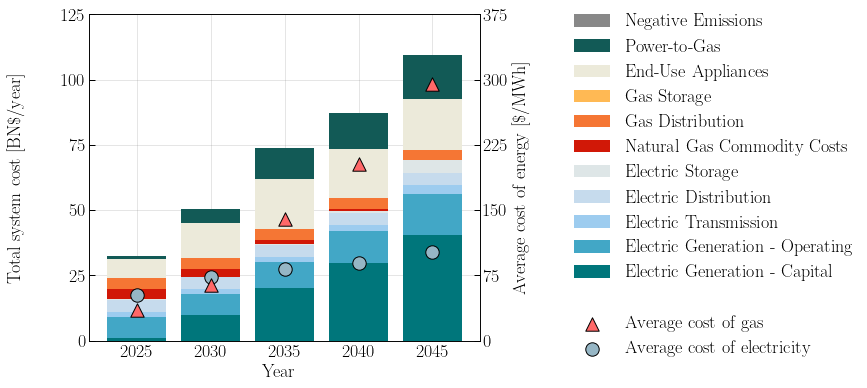

In [45]:
fig, axes = plt.subplots(1, 1, figsize = (7,6), sharex = False, sharey = False)

data = np.transpose(pd.read_csv(f"%s/EMISSIONS_COSTS.csv" % folder).to_numpy())
stack = np.zeros((T_inv))
count = 8
for k in range(len(labels_Costs)):
    if k == 0:
        axes.bar(Years, data[3,:]/10**9, label = labels_Costs[k],color = colors_Costs[k], bottom = stack, width = 4, align = "center")
        stack = stack + data[3,:]/10**9
    if k == 1:
        axes.bar(Years, (data[4,:] + data[5,:])/10**9, label = labels_Costs[k],color = colors_Costs[k], bottom = stack, width = 4, align = "center")
        stack = stack + (data[4,:] + data[5,:])/10**9
    if k == 2:
        axes.bar(Years, (data[19,:] +data[24,:])/10**9, label = labels_Costs[k],color = colors_Costs[k], bottom = stack, width = 4, align = "center")
        stack = stack + (data[19,:] +data[24,:])/10**9  
    if k == 3:
        axes.bar(Years, data[7,:]/10**9, label = labels_Costs[k],color = colors_Costs[k], bottom = stack, width = 4, align = "center")
        stack = stack + data[7,:]/10**9  
    if k == 4:
        axes.bar(Years, data[6,:]/10**9, label = labels_Costs[k],color = colors_Costs[k], bottom = stack, width = 4, align = "center")
        stack = stack + data[6,:]/10**9  
    if k > 4:
        axes.bar(Years, data[count,:]/10**9, label = labels_Costs[k],color = colors_Costs[k], bottom = stack, width = 4, align = "center")
        stack = stack + data[count,:]/10**9
        print(count,labels_Costs[k], data[count,:]/10**9)
        count = count+1
        
axes2 = axes.twinx()

# Scatter for average gas and electricity costs
axes2.scatter(Years,data[0,:], label = "Average cost of electricity", color = "#96B6C5", edgecolors= 'k', s = 180)
axes2.scatter(Years,data[1,:], label = "Average cost of gas", color = "#FF6868", edgecolors= 'k' , s = 180,marker="^")
axes.tick_params(direction='in', length=6, width=1, colors='k')
axes2.tick_params(direction='in', length=6, width=1, colors='k')
axes.axhline(linewidth=1, color='k')
axes2.axhline(linewidth=1, color='k')

handles, labels = axes.get_legend_handles_labels()
axes.legend(handles[::-1], labels[::-1], bbox_to_anchor=(1.2, 1.05), loc='upper left',frameon=False)
handles, labels = axes2.get_legend_handles_labels()
axes2.legend(handles[::-1], labels[::-1], bbox_to_anchor=(1.2, -0.1), loc='lower left',frameon=False)
axes.set_ylim([0,125])
axes2.set_ylim([0,375])
fig.text(-0.02, 0.5, 'Total system cost [BN\$/year]', ha='center', va='center', rotation='vertical')
axes.set_axisbelow(True)
axes.grid(color='grey', linestyle='-', linewidth=1,alpha = 0.2)
axes.set_yticks(np.arange(0,150, step=25))
axes2.set_yticks(np.arange(0,400, step=75))

axes2.set_ylabel("Average cost of energy [\$/MWh]")
fig.text(0.5, 0.04, 'Year', ha='center')
if to_plot:
    fig.savefig(f"Plots/{case_study}/Total_Costs.png",bbox_inches = "tight", dpi = 300)
plt.show()

Electric Generation - Capital [50.7029895  42.57391384 34.25581116 22.7769825   0.10279534]
Electric Generation - Operating [45.32481633 37.37915227 29.42260268 17.15277378  6.6516413 ]


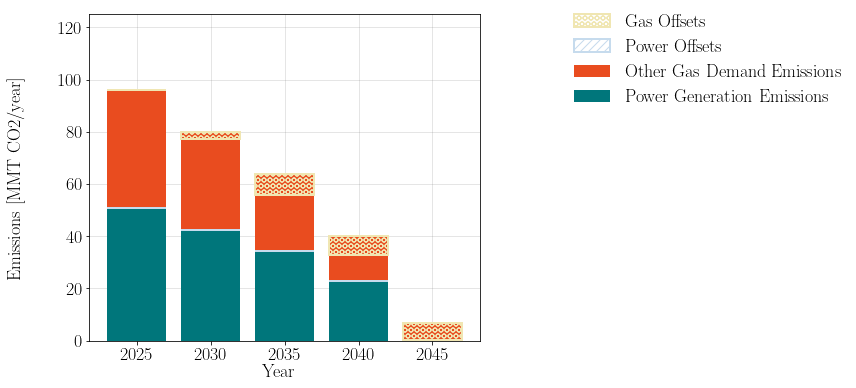

In [86]:
fig, axes = plt.subplots(1, 1, figsize = (7,6), sharex = False, sharey = False)

for i in range(len(appliance_cases)):
    data = np.transpose(pd.read_csv(f"%s/EMISSIONS_COSTS.csv" % folder).to_numpy())
    stack = np.zeros((T_inv))
    resources_bg = stack
    count = 20
    for k in range(len(labels_emissions)):
        axes.bar(Years, data[count,:]/10**6, label = labels_emissions[k],color = colors_emissions[k], bottom = stack, width = 4, align = "center")
        stack = stack + data[count,:]/10**6       
        print(labels_Costs[k],data[count,:]/10**6)
        count = count+1
        
    stack = np.zeros((T_inv))
    axes.bar(Years, data[count,:]/10**6, label = "Power Offsets", color = "none", alpha = 1, hatch='///', edgecolor = '#C6DBED',linewidth = 2, bottom = data[20,:]/10**6-data[22,:]/10**6, width = 4, align = "center")
    axes.bar(Years, data[count+1,:]/10**6, label = "Gas Offsets", color = "none", alpha = 1, hatch='OO', linewidth = 2,edgecolor = '#F0E6B2', bottom = data[20,:]/10**6+data[21,:]/10**6-data[23,:]/10**6, width = 4, align = "center")

axes.set_axisbelow(True)
axes.grid(color='grey', linestyle='-', linewidth=1,alpha = 0.2)
handles, labels = axes.get_legend_handles_labels()
axes.legend(handles[::-1], labels[::-1], bbox_to_anchor=(1.2, 1.05), loc='upper left',frameon=False)
axes.set_ylim([0,125])
fig.text(-0.02, 0.5, 'Emissions [MMT CO2/year]', ha='center', va='center', rotation='vertical')
fig.text(0.5, 0.04, 'Year', ha='center')
if to_plot:
    fig.savefig(f"Plots/{case_study}/Emissions.png",bbox_inches = "tight", dpi = 300)
plt.show()

## Locational Plots

<ipython-input-56-fee1f17fccd0>:39: RuntimeWarning:

invalid value encountered in divide



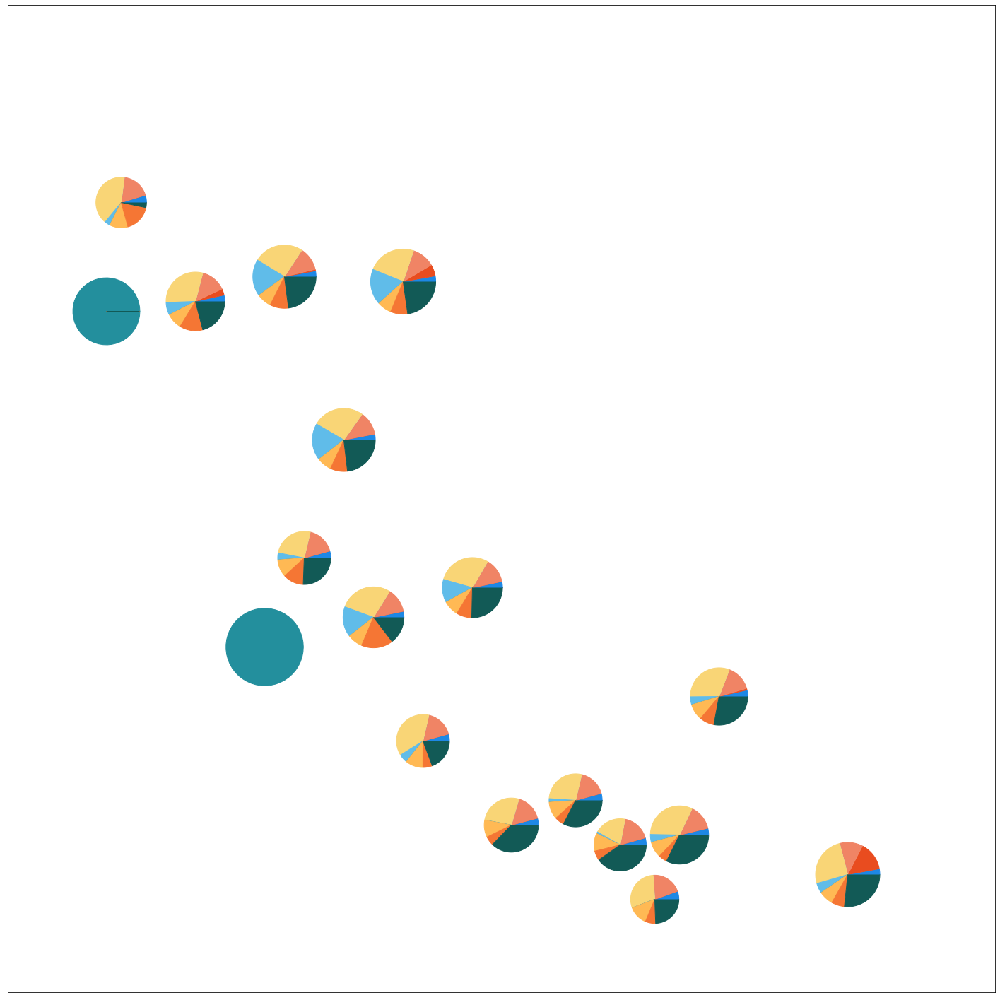

In [56]:
# Total cumulative build

result_yr = 5

fig, axes = plt.subplots(1, 1, figsize = (20,20), sharex = True, sharey = True)
xx = 0

# img = plt.imread("Plots/climatezone.png")
# axes.imshow(img, extent=[0.5, 10.5, 0, 10])

nodal_locs = np.random.rand(np.max(locational_resources),2)
nodal_locs[:,0] = np.array([1.15,1.9, 3.0 ,  3.7,  4.20, 5.1,  6.55,  6.2, 5.75, 6.8, 2.80, 3.4, 4.7, 7.2, 8.5, 4.0, 2.9 ,4.7,8.5,9,1.0, 2.6])
nodal_locs[:,1] = np.array([8   ,  7, 4.4 ,  3.8,  2.55, 1.7,  0.95,  1.5, 1.95, 1.6, 7.25, 5.6, 4.1, 3.0, 1.2, 7.2, 9.85,7.6,3.8,1.2,6.9, 3.5])

for ii in range(len(appliance_cases)):
    data_plot = np.zeros((np.max(locational_resources),len(unique_resources)))
    data = pd.read_csv(f"%s/CAPACITY_BUILT.csv" % folder).to_numpy()
    data = data[0:-1,:]
    data_retired = pd.read_csv(f"%s/CAPACITY_RETIRED.csv" % folder).to_numpy()
    data_retired = data_retired[0:-1,:]
    stack = np.zeros((T_inv))
    stack_minus = stack.copy()
    for kk in range(np.max(locational_resources)):
        resources = np.zeros((len(unique_resources),T_inv))
        resources_minus = np.zeros((len(unique_resources),T_inv))
        for k in range(len(unique_resources)):
            for j in range(T_inv):
                for jj in range(j+1):
                    resources_minus[k,j] = resources_minus[k,j]+np.sum(data_retired[(resource_list == unique_resources[k]) & (locational_resources == kk+1),jj],0)
                    resources[k,j] = resources[k,j]+np.sum(data[(resource_list == unique_resources[k]) & (locational_resources == kk+1),jj],0)

            data_plot[kk,k] = resources[k,result_yr-1]
            
    sizes = 550*np.random.rand(np.max(locational_resources)) + 250
    sizes = np.sum(data_plot,1)*0.6
    for i in range(len(data_plot[:,0])):
        r = np.zeros((len(data_plot[0,:])+1))
        loc = nodal_locs[i,:]
        cum_data = np.cumsum(data_plot[i,:]) / np.cumsum(data_plot[i,:])[-1]
        cum_data[np.isnan(cum_data)] = 0
        for j in range(len(data_plot[0,:])):
            r[j+1] = cum_data[j]
            x = np.cos(2 * np.pi * np.linspace(r[j], r[j+1]))
            y = np.sin(2 * np.pi * np.linspace(r[j], r[j+1]))
            xy = np.row_stack([[0, 0], np.column_stack([x, y])])
            s1 = np.abs(xy).max()
            axes.scatter(loc[0], loc[1], marker=xy, s=s1**2 * sizes[i], facecolor = colors[j])
    axes.set_xticks([])
    axes.set_yticks([])
    axes.set_xlim([0,10])
    axes.set_ylim([0,10])
    # axes.patch.set_facecolor('white')
    axes.patch.set_alpha(0.7)
if to_plot:
    fig.savefig(f"Plots/{case_study}/Locational_CAP_{result_yr}.png", transparent=True,bbox_inches = "tight", dpi = 300)
plt.tight_layout()


<ipython-input-51-bf6857edba43>:36: RuntimeWarning: invalid value encountered in divide
  cum_data = np.cumsum(data_plot[i,:]) / np.cumsum(data_plot[i,:])[-1]


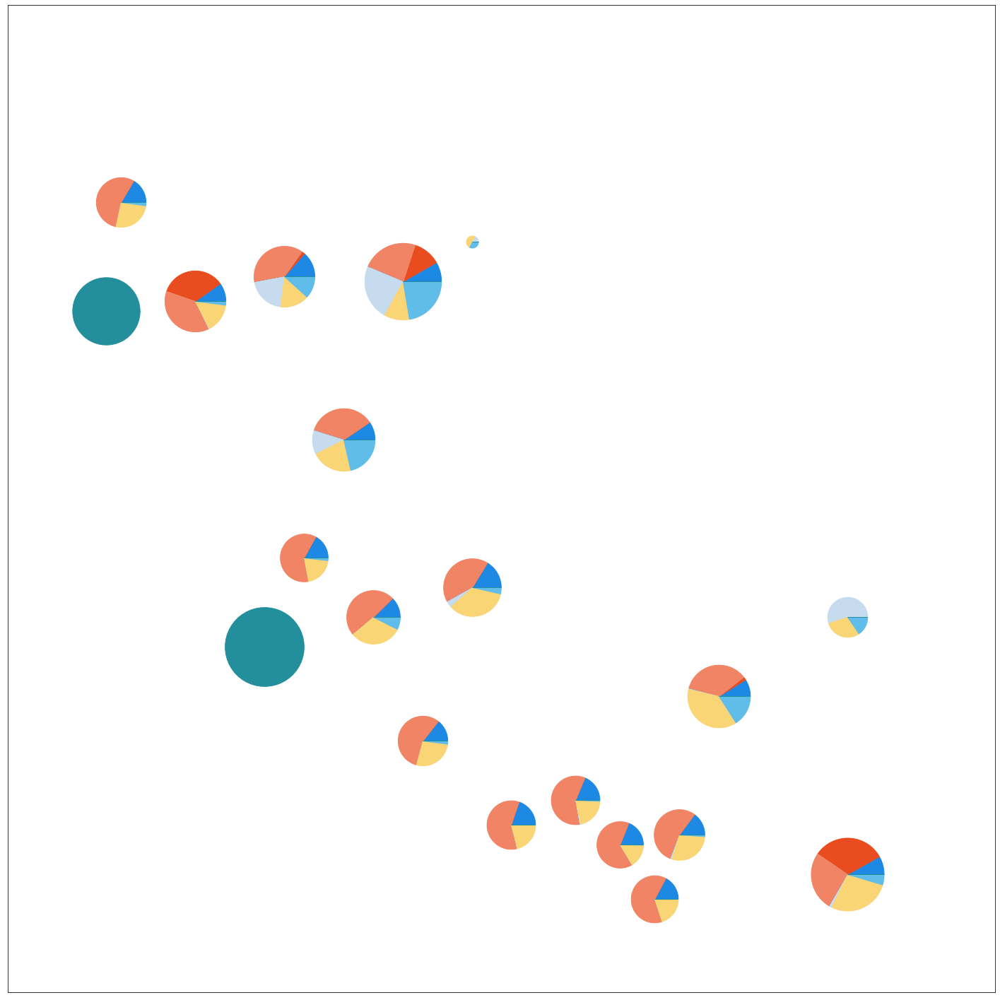

In [51]:
# Generation breakdown

result_yr = 5

fig, axes = plt.subplots(1, 1, figsize = (20,20), sharex = True, sharey = True)
xx = 0

# img = plt.imread("Plots/climatezone.png")
# axes.imshow(img, extent=[0.5, 10.5, 0, 10])

nodal_locs = np.random.rand(np.max(locational_resources_GEN),2)
nodal_locs[:,0] = np.array([1.15,1.9, 3.0 ,  3.7,  4.20, 5.1,  6.55,  6.2, 5.75, 6.8, 2.80, 3.4, 4.7, 7.2, 8.5, 4.0, 2.9 ,4.7,8.5,9,1.0, 2.6])
nodal_locs[:,1] = np.array([8   ,  7, 4.4 ,  3.8,  2.55, 1.7,  0.95,  1.5, 1.95, 1.6, 7.25, 5.6, 4.1, 3.0, 1.2, 7.2, 9.85,7.6,3.8,1.2,6.9, 3.5])

for ii in range(len(appliance_cases)):
    data_plot = np.zeros((np.max(locational_resources_GEN),len(unique_resources_GEN)))
    data = pd.read_csv(f"%s/GENERATION.csv" % folder).to_numpy()
    data = data[0:-1,:]
    data = data[0:237]
    stack = np.zeros((T_inv))
    stack_minus = stack.copy()
    for kk in range(np.max(locational_resources_GEN)):
        resources = np.zeros((len(unique_resources_GEN),T_inv))
        for k in range(len(unique_resources_GEN)):
            for j in range(T_inv):
                    for jj in range(j+1):
                        resources[k,j] = np.sum(data[(resource_list_GEN == unique_resources_GEN[k]) & (locational_resources_GEN == kk+1),jj],0)

            data_plot[kk,k] = resources[k,result_yr-1]
            
    sizes = np.random.rand(np.max(locational_resources_GEN))
    sizes = np.sum(data_plot,1)*0.0002
    for i in range(len(data_plot[:,0])):
        r = np.zeros((len(data_plot[0,:])+1))
        loc = nodal_locs[i,:]
        cum_data = np.cumsum(data_plot[i,:]) / np.cumsum(data_plot[i,:])[-1]
        cum_data[np.isnan(cum_data)] = 0
        for j in range(len(data_plot[0,:])):
            r[j+1] = cum_data[j]
            x = np.cos(2 * np.pi * np.linspace(r[j], r[j+1]))
            y = np.sin(2 * np.pi * np.linspace(r[j], r[j+1]))
            xy = np.row_stack([[0, 0], np.column_stack([x, y])])
            s1 = np.abs(xy).max()
            axes.scatter(loc[0], loc[1], marker=xy, s=s1**2 * sizes[i], facecolor = colors[j])
    axes.set_xticks([])
    axes.set_yticks([])
    axes.set_xlim([0,10])
    axes.set_ylim([0,10])
    # axes.patch.set_facecolor('white')
    axes.patch.set_alpha(0.7)
if to_plot:
    fig.savefig(f"Plots/{case_study}/Locational_GEN_{result_yr}.png", transparent=True,bbox_inches = "tight", dpi = 300)
plt.tight_layout()


### Choropleth Plot

In [65]:
geofile = 'Plots/BuildingClimateZones.geojson'
with open(geofile) as response:
    climatezone = json.load(response)

data = pd.read_csv("Plots/appliances.csv")
appliancecount = data["Appliance Count"].values.reshape(7, -1)
appliance_labels = ["Res. Water Heater","Res. Space Heater","Res. Kitchen Range","Com. Water Heater","Com. Space Heater","Res. Space Heater + AC","Com. Space Heater + AC"]
my_case = "Net Cost [Mid]"
folderZ = "core/Output/v3/App Slow/APPLIANCE_DECISIONS.csv"

netcost_plot = data[my_case].values.reshape(7, -1)
dataX = pd.read_csv(folderZ)
remainingcount = dataX["Column15"].values.reshape(14, -1)
remainingcount = remainingcount[1::2, :]
electrified = remainingcount*1000./appliancecount

df = {
    'BZone': ['1','10','11','12','13','14','15','16','2','3','4','5','6','7','8','9'], 
     'unemp': electrified[1,:]
    }

fig = px.choropleth(df, geojson=climatezone, locations='BZone', color='unemp',
                           color_continuous_scale="Darkmint",
                           range_color=(0, 1),
                           labels={'unemp':'Electrified [%]'}
                          )
fig.update_geos(fitbounds="locations",visible=False)
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0},font_family="Computer Modern",font=dict(size=18))
fig.update_traces(marker_line_color="white",marker_line_width=0.2)
to_plot = True  
if to_plot:
    fig.write_image(f"Plots/{case_study}/Locational_Electrification.png",scale=2)
fig.show()

In [60]:
# fig, axes = plt.subplots(16, 2, figsize=(6, 32), sharex=True, sharey=False)
peak_nodal = np.transpose(pd.read_csv(f"%s/PEAKDEMANDINC.csv" % folder).to_numpy())
# peak_nodal = np.transpose(pd.read_csv(f"%s/PEAKDEMAND.csv" % folder).to_numpy())
percent_change_arr = np.zeros(16)
for region_index in range(16):   
    peak_cz = peak_nodal[region_index,:]
    original_no = peak_nodal[region_index,0]
    percent_change = (peak_cz - original_no)/original_no*100
    percent_change_arr[region_index] = np.around(percent_change[4], decimals = 0)

df = {
    'BZone': ['1','10','11','12','13','14','15','16','2','3','4','5','6','7','8','9'], 
     'unemp': percent_change_arr
    }

fig = px.choropleth(df, geojson=climatezone, locations='BZone', color='unemp',
                           color_continuous_scale="Darkmint",
                           range_color=(0, np.max(percent_change_arr)),
                           labels={'unemp':'Peak Inc Demand [% Change]'}
                          )
fig.update_geos(fitbounds="locations",visible=False)
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0},font_family="Computer Modern",font=dict(size=18))
fig.update_traces(marker_line_color="white",marker_line_width=0.2)
  
if to_plot:
    fig.write_image(f"Plots/{case_study}/Locational_PeakIncDemand.png",scale=2)
fig.show()

plt.show()

## Validation

### Appliance Profile

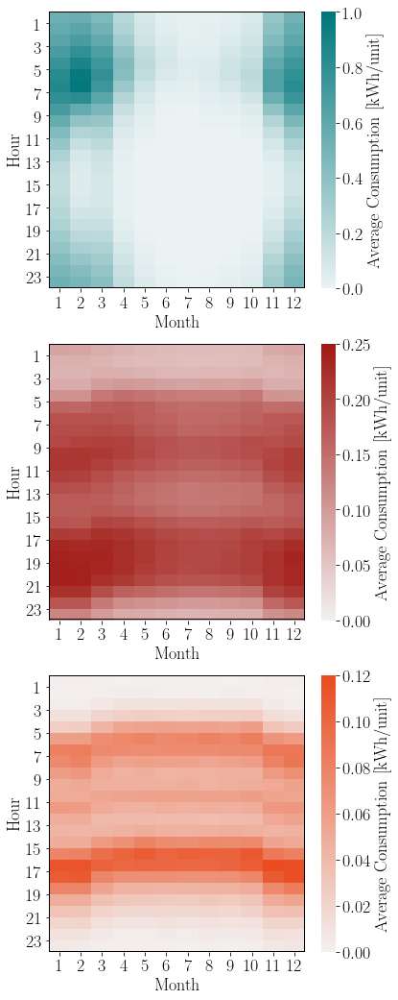

In [62]:
data = pd.read_csv("Data/ApplianceProfiles_ELECNetworkCold.csv")
timestamp = pd.read_csv("Plots/2018_time.csv")
month = timestamp["Month"]
hour = timestamp["Hour"]
index_profile = ["x18","x50","x82"] # x50 SH CZ2, x18 WH CZ2
hourly_av = np.zeros((len(index_profile),12,24))
for i in range(len(index_profile)):
    app_profile = data[index_profile[i]]
    for j in range(8760):
        hourly_av[i,month[j]-1,hour[j]-1] += app_profile[j]

days_in_month = [31,28,31,30,31,30,31,31,30,31,30,31]
for m in range(12):
    hourly_av[:,m,:] = hourly_av[:,m,:]/days_in_month[m]*1000

colors_ResApps = ["#E94C1F","#ECEADA","#A01813","#FDDBC7","#125A56","#00767B","#DEE6E7","#DEE6E7"]

fig,(ax1,ax2,ax3) = plt.subplots(3,1, figsize = (6,18))
ax1.get_shared_y_axes().join(ax2,ax3)

x_axis_labels = [1,2,3,4,5,6,7,8,9,10,11,12]
l = np.arange(1, 24+1, 2)

cmap_sh = sns.color_palette("light:#00767B", as_cmap=True)
p2 = sns.heatmap(np.transpose(hourly_av[1,:,:]),cmap=cmap_sh,xticklabels=x_axis_labels, vmin=0, vmax=1,
                 ax=ax1,cbar_kws={'label': 'Average Consumption [kWh/unit]'})
p2.set(xlabel='Month', ylabel='Hour',yticks=l, yticklabels=l)
p2.set_yticklabels(rotation=0,labels=l)

cmap_wh = sns.color_palette("light:#A01813", as_cmap=True)
p1 = sns.heatmap(np.transpose(hourly_av[0,:,:]),cmap=cmap_wh,xticklabels=x_axis_labels, vmin=0, vmax=0.25,
                 ax=ax2,cbar_kws={'label': 'Average Consumption [kWh/unit]'})
p1.set(xlabel='Month', ylabel='Hour',yticks=l, yticklabels=l)
p1.set_yticklabels(rotation=0,labels=l)

cmap_ck = sns.color_palette("light:#E94C1F", as_cmap=True)
p3 = sns.heatmap(np.transpose(hourly_av[2,:,:]),cmap=cmap_ck,xticklabels=x_axis_labels, vmin=0, vmax=0.12,
                 ax=ax3,cbar_kws={'label': 'Average Consumption [kWh/unit]'})
p3.set(xlabel='Month', ylabel='Hour',yticks=l, yticklabels=l)
p3.set_yticklabels(rotation=0,labels=l)

p1.axhline(y = 0, color='k',linewidth = 1) 
p1.axhline(y = 23.9, color = 'k', linewidth = 1) 
p1.axvline(x = 0, color = 'k', linewidth = 1) 
p1.axvline(x = 11.95,  color = 'k', linewidth = 1) 
p2.axhline(y = 0, color='k',linewidth = 1) 
p2.axhline(y = 23.9, color = 'k', linewidth = 1) 
p2.axvline(x = 0, color = 'k', linewidth = 1) 
p2.axvline(x = 11.95,  color = 'k', linewidth = 1) 
p3.axhline(y = 0, color='k',linewidth = 1) 
p3.axhline(y = 23.9, color = 'k', linewidth = 1) 
p3.axvline(x = 0, color = 'k', linewidth = 1) 
p3.axvline(x = 11.95,  color = 'k', linewidth = 1) 

if to_plot:
    fig.savefig(f"Plots/Validation/Data - Hourly Average Appliances.png", transparent=True,bbox_inches = "tight", dpi = 300)
plt.show()


### Generation Profile

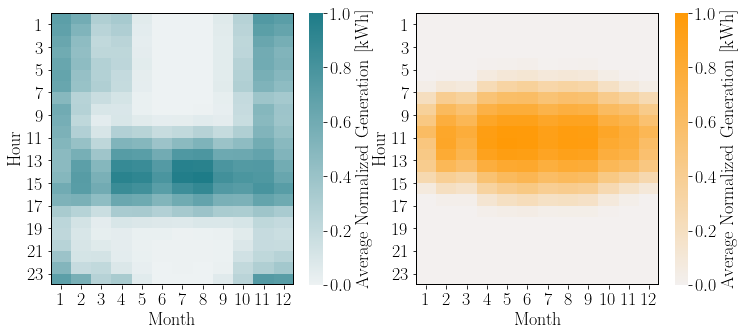

In [63]:
unique_resources = np.array(['Coal', 'Natural Gas', 'Biomass', 'Geothermal', 'Nuclear',
 'Hydro', 'Solar PV', 'Wind', 'Offshore Wind',
 'Short-Duration Storage', 'Long-Duration Storage','Power-to-Gas'])
unique_resources_GEN = unique_resources[:-3]
colors = np.array(['#000000','#888888', '#00767B', '#E94C1F', '#A01813',
    '#C6DBED', '#F9D576','#60BCE9', '#238F9D', 
    '#FFB954', '#F57634','#125A56'])

dataX = pd.read_csv(f"%s/HOURLY_GENERATION.csv" % folder).to_numpy()
yr = 4

data = dataX[0:-1,int(yr*8760):int((yr+1)*8760)]/1000       # data follows resource_list_hourly
resources = np.zeros((8760,2))
for k in [9]:
    resources[:,0] += np.maximum(data[107],0)
for k in [6]:
    resources[:,1] += np.maximum(data[20],0)
    # print(unique_resources_GEN[k])

hourly_vre = np.zeros((2,12,24))
for j in range(8760):
    hourly_vre[0,month[j]-1,hour[j]-1] += resources[j,0]
    hourly_vre[1,month[j]-1,hour[j]-1] += resources[j,1]

days_in_month = [31,28,31,30,31,30,31,31,30,31,30,31]
for m in range(12):
    hourly_vre[:,m,:] = hourly_vre[:,m,:]/days_in_month[m]*1000
hourly_vre[0,:,:] = hourly_vre[0,:,:]/np.max(hourly_vre[0,:,:])
hourly_vre[1,:,:] = hourly_vre[1,:,:]/np.max(hourly_vre[1,:,:])

fig,(ax1,ax2) = plt.subplots(1,2, figsize = (12,5))
x_axis_labels = [1,2,3,4,5,6,7,8,9,10,11,12]
l = np.arange(1, 24+1, 2)

cmap_wh = sns.color_palette("light:#1e7c88", as_cmap=True)
p1 = sns.heatmap(np.transpose(hourly_vre[0,:,:]),cmap=cmap_wh,xticklabels=x_axis_labels,
                 ax=ax1,cbar_kws={'label': 'Average Normalized Generation [kWh]'})
p1.set(xlabel='Month', ylabel='Hour',yticks=l, yticklabels=l)
p1.set_yticklabels(rotation=0,labels=l)

cmap_wh = sns.color_palette("light:#ff9a07", as_cmap=True)
p2 = sns.heatmap(np.transpose(hourly_vre[1,:,:]),cmap=cmap_wh,xticklabels=x_axis_labels,
                 ax=ax2,cbar_kws={'label': 'Average Normalized Generation [kWh]'})
p2.set(xlabel='Month', ylabel='Hour',yticks=l, yticklabels=l)
p2.set_yticklabels(rotation=0,labels=l)

p1.axhline(y = 0, color='k',linewidth = 1) 
p1.axhline(y = 23.9, color = 'k', linewidth = 1) 
p1.axvline(x = 0, color = 'k', linewidth = 1) 
p1.axvline(x = 11.95,  color = 'k', linewidth = 1) 
p2.axhline(y = 0, color='k',linewidth = 1) 
p2.axhline(y = 23.9, color = 'k', linewidth = 1) 
p2.axvline(x = 0, color = 'k', linewidth = 1) 
p2.axvline(x = 11.95,  color = 'k', linewidth = 1) 

if to_plot:
    fig.savefig(f"Plots/Validation/Data - Hourly Average Renewables.png", transparent=True,bbox_inches = "tight", dpi = 300)
plt.show()